In [72]:
import pandas as pd

df = pd.read_csv('/dataset.csv')


In [73]:
print(df.columns)

Index(['VIN (1-10)', 'County', 'City', 'State', 'Postal Code', 'Model Year',
       'Make', 'Model', 'Electric Vehicle Type',
       'Clean Alternative Fuel Vehicle (CAFV) Eligibility', 'Electric Range',
       'Base MSRP', 'Legislative District', 'DOL Vehicle ID',
       'Vehicle Location', 'Electric Utility', '2020 Census Tract'],
      dtype='object')


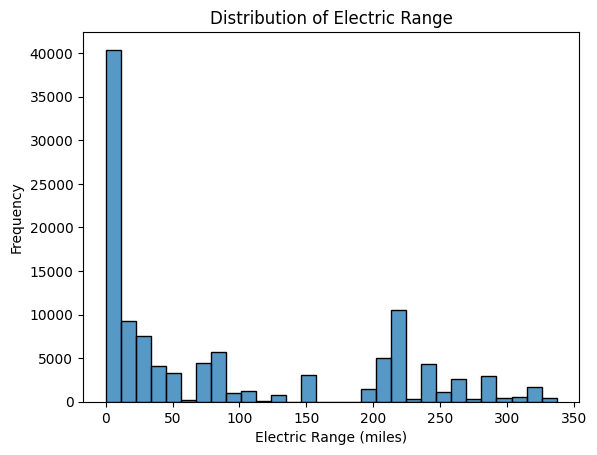

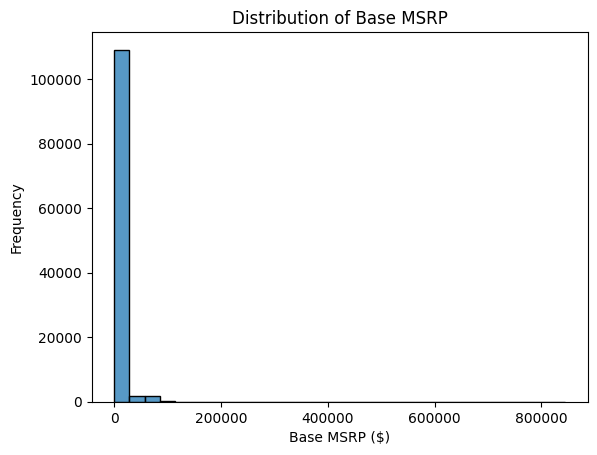

In [74]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
df = pd.read_csv('/dataset.csv')
sns.histplot(df['Electric Range'], bins=30)
plt.title('Distribution of Electric Range')
plt.xlabel('Electric Range (miles)')
plt.ylabel('Frequency')
plt.show()
sns.histplot(df['Base MSRP'], bins=30)
plt.title('Distribution of Base MSRP')
plt.xlabel('Base MSRP ($)')
plt.ylabel('Frequency')
plt.show()


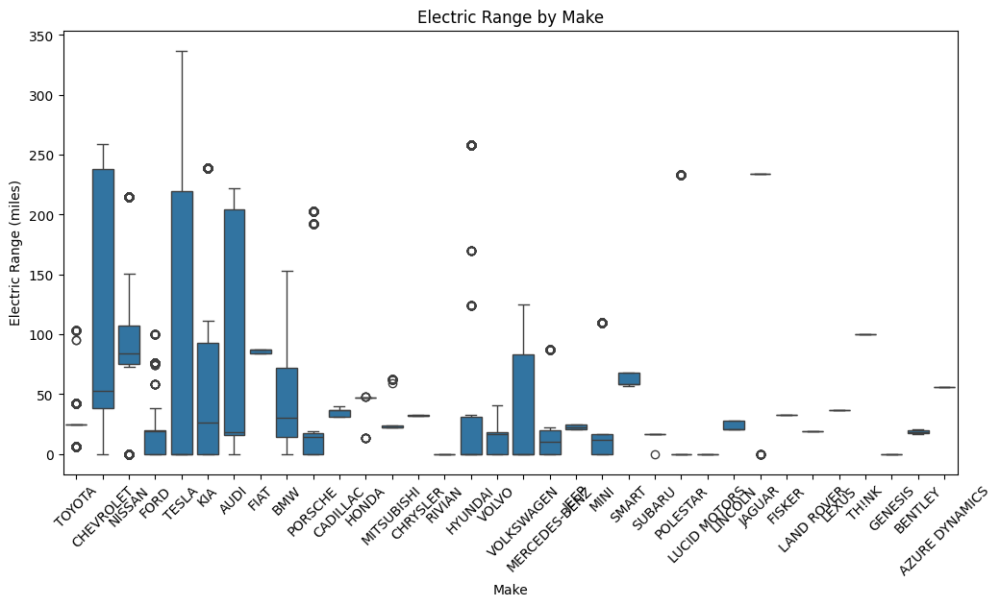

In [75]:
plt.figure(figsize=(12, 6))
sns.boxplot(data=df, x='Make', y='Electric Range')
plt.xticks(rotation=45)
plt.title('Electric Range by Make')
plt.ylabel('Electric Range (miles)')
plt.show()


In [82]:
import pandas as pd
import plotly.express as px
df = pd.read_csv('/dataset.csv')
choropleth_data = df.groupby('County').size().reset_index(name='EV Count')
print(choropleth_data)
fig = px.choropleth(
    choropleth_data,
    geojson='https://raw.githubusercontent.com/OpenGovUS/geojson/master/county.json',
    locations='County',
    featureidkey="properties.NAME",
    color='EV Count',
    color_continuous_scale='Viridis',
    scope='usa',
    title='Number of Electric Vehicles by County',
)
fig.update_geos(fitbounds="locations", visible=False)
fig.show()


           County  EV Count
0           Adams        35
1         Alameda         2
2      Alexandria         8
3       Allegheny         1
4    Anne Arundel         9
..            ...       ...
160       Whatcom      2840
161       Whitman       177
162       Wichita         2
163      Williams         1
164        Yakima       617

[165 rows x 2 columns]


In [77]:
!pip install plotly


In [8]:
import pandas as pd

df = pd.read_csv('/dataset.csv')


In [60]:
import plotly.express as px


In [62]:
scatter_plot = px.scatter(df,
                           x='Electric Range',
                           y='Base MSRP',
                           title='Scatter Plot of Electric Range vs Base MSRP')
scatter_plot.show()


In [63]:
box_plot = px.box(df,
                  x='Electric Vehicle Type',
                  y='Electric Range',
                  title='Box Plot of Electric Range by Electric Vehicle Type')t
box_plot.show()


In [64]:
ev_type_counts = df['Electric Vehicle Type'].value_counts().reset_index()
ev_type_counts.columns = ['Electric Vehicle Type', 'Count']
pie_chart = px.pie(ev_type_counts,
                   names='Electric Vehicle Type',
                   values='Count',
                   title='Distribution of Electric Vehicles by Type')
pie_chart.show()


In [65]:
choropleth = px.choropleth(
    county_counts,
    locations='County',
    locationmode='USA-states',
    color='EV Count',
    title='Choropleth Map of Electric Vehicles by County and State',
    color_continuous_scale=px.colors.sequential.Plasma,
    labels={'EV Count': 'Number of Electric Vehicles'},
)


In [68]:
county_counts = df.groupby(['County', 'State', 'Model Year']).size().reset_index(name='EV Count')


In [12]:
fig = px.pie(df, names='Make', values='Base MSRP', title='Distribution of Base MSRP by Make')
fig.show()


In [13]:
choropleth_data = df.groupby('State').size().reset_index(name='EV Count')
fig = px.choropleth(choropleth_data,
                    locations='State',
                    locationmode='USA-states',
                    color='EV Count',
                    color_continuous_scale='Viridis',
                    title='Number of EV Vehicles by State')
fig.show()


In [70]:
animated_data = df.groupby(['Model Year', 'State']).size().reset_index(name='EV Count')
fig = px.choropleth(animated_data,
                    locations='State',
                    locationmode='USA-states',
                    color='EV Count',
                    animation_frame='Model Year',
                    color_continuous_scale='Viridis',
                    title='Number of EV Vehicles by State Over Years')
fig.show()


In [16]:
import pandas as pd
import plotly.express as px
df = pd.read_csv('/dataset.csv')
fig1 = px.histogram(df, x='Electric Range', title='Distribution of Electric Range')
fig1.show()
fig2 = px.box(df, y='Base MSRP', title='Box Plot of Base MSRP')
fig2.show()


In [17]:
fig3 = px.scatter(df, x='Base MSRP', y='Electric Range', color='Make',
                   title='Base MSRP vs Electric Range by Make')
fig3.show()
fig4 = px.box(df, x='Make', y='Electric Range', title='Electric Range by Make')
fig4.show()


In [58]:
import pandas as pd
import plotly.express as px
df = pd.read_csv('/dataset.csv')
county_counts = df.groupby(['County', 'State']).size().reset_index(name='EV Count')
choropleth = px.choropleth(
    county_counts,
    locations='County',
    locationmode='USA-states',
    color='EV Count',
    title='Choropleth Map of Electric Vehicles by County and State',
    color_continuous_scale=px.colors.sequential.Plasma,
    labels={'EV Count': 'Number of Electric Vehicles'},
)
choropleth.show()


In [19]:
import plotly.express as px
df_racing = df.groupby(['Model Year', 'Make']).size().reset_index(name='Count')
fig5 = px.bar(df_racing, x='Count', y='Make', color='Make',
               animation_frame='Model Year',
               title='Racing Bar Plot of EV Makes Over the Years',
               range_x=[0, df_racing['Count'].max()])
fig5.show()


In [47]:
!pip install bar_chart_race


In [48]:
import bar_chart_race as bcr


In [51]:
import bar_chart_race as bcr
bcr.bar_chart_race(
    df=final,
    filename="final.mp4",
    orientation="h",
    sort="desc",
    n_bars=10,
    steps_per_period=45,
    period_length=3000,
    title='Year wise sales of each Maker from last decade',
    period_label={'x': .95, 'y': .15, 'ha': 'right', 'va': 'center', 'size': 72}
)


In [53]:
from IPython.display import Video
Video("final.mp4")


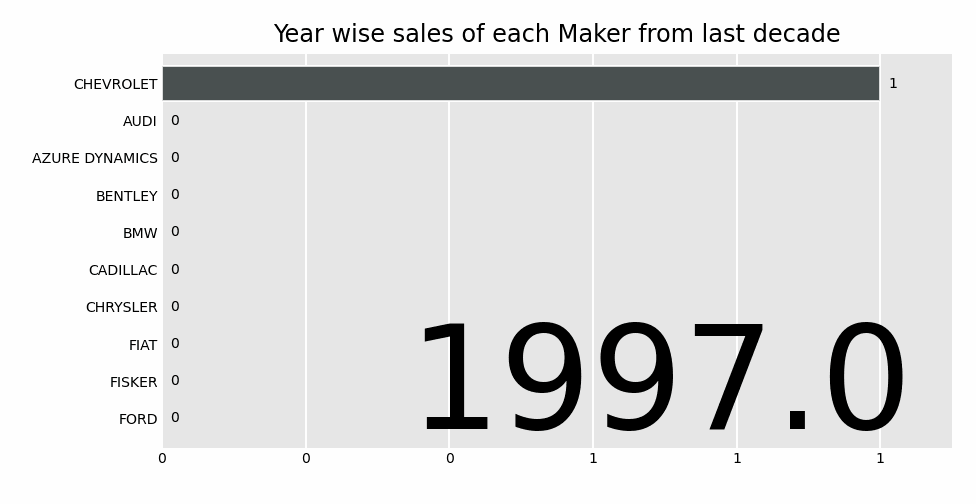

In [54]:
bcr.bar_chart_race(
    df=final,
    filename="final.gif",
    orientation="h",
    sort="desc",
    n_bars=10,
    steps_per_period=45,
    period_length=3000,
    title='Year wise sales of each Maker from last decade',
    period_label={'x': .95, 'y': .15, 'ha': 'right', 'va': 'center', 'size': 72}
)
from IPython.display import Image
Image(filename="final.gif")


In [55]:
import pandas as pd
df = pd.read_csv('/dataset.csv')
print(df.head())
print(df.columns)


   VIN (1-10)     County      City State  Postal Code  Model Year       Make  \
0  JTMEB3FV6N     Monroe  Key West    FL        33040        2022     TOYOTA   
1  1G1RD6E45D      Clark  Laughlin    NV        89029        2013  CHEVROLET   
2  JN1AZ0CP8B     Yakima    Yakima    WA        98901        2011     NISSAN   
3  1G1FW6S08H     Skagit  Concrete    WA        98237        2017  CHEVROLET   
4  3FA6P0SU1K  Snohomish   Everett    WA        98201        2019       FORD   

        Model                   Electric Vehicle Type  \
0  RAV4 PRIME  Plug-in Hybrid Electric Vehicle (PHEV)   
1        VOLT  Plug-in Hybrid Electric Vehicle (PHEV)   
2        LEAF          Battery Electric Vehicle (BEV)   
3     BOLT EV          Battery Electric Vehicle (BEV)   
4      FUSION  Plug-in Hybrid Electric Vehicle (PHEV)   

  Clean Alternative Fuel Vehicle (CAFV) Eligibility  Electric Range  \
0           Clean Alternative Fuel Vehicle Eligible              42   
1           Clean Alternative Fuel